<a href="https://colab.research.google.com/github/Kira1108/play-image-gen/blob/main/StableDiffusion.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [38]:
#@title 环境准备
from IPython.display import clear_output
!pip install diffusers transformers datasets accelerate pillow

from diffusers import StableDiffusionPipeline  
from diffusers import DPMSolverMultistepScheduler                                                                                                                                                                                             
                                                                                                                                                                                                                                                 
import torch
from PIL import Image  

class ImGen:
    
    def __init__(self, model_id:str="runwayml/stable-diffusion-v1-5", **kwargs):
        self.pipe = StableDiffusionPipeline.from_pretrained(model_id, torch_dtype = torch.float16, **kwargs)
        self.pipe.to("cuda")
        self.images = None

    def set_vae(self, vae):
        self.pipe.vae = vae

    def sequential(self):
        self.pipe.enable_attention_slicing()

    def set_scheduler(self, scheduler):
        self.pipe.scheduler = scheduler

    def grid(self, prompt:str, **kwargs):
        return self.pipe(prompt, **kwargs).images
    
    def __call__(self, prompt:str, **kwargs):
        return self.grid(prompt, **kwargs)[0]

clear_output()

In [39]:
pipe = ImGen()
clear_output()

  0%|          | 0/20 [00:00<?, ?it/s]

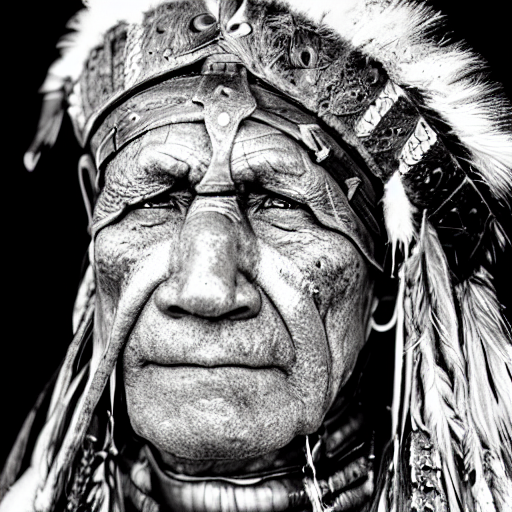

In [40]:
# be free to set scheduler
pipe.set_scheduler(DPMSolverMultistepScheduler.from_config(pipe.pipe.scheduler.config))

# be free to set generator
generator = torch.Generator("cuda").manual_seed(0)  

# be free to set num_inference_step
num_inference_steps = 20

prompt = "portrait photo of a old warrior chief"   
 
image = pipe(prompt, generator = generator, num_inference_steps = num_inference_steps)
image

In [41]:
def get_inputs(batch_size=1):                                                                                                                                                                                                                 
    generator = [torch.Generator("cuda").manual_seed(i) for i in range(batch_size)]                                                                                                                                                             
    prompts = batch_size * [prompt]                                                                                                                                                                                                             
    num_inference_steps = 20                                                                                                                                                                                                                    

    return {"prompt": prompts, "generator": generator, "num_inference_steps": num_inference_steps}  
                                                                                                                                                                                                                    

def image_grid(imgs, rows=2, cols=2):                                                                                                                                                                                                         
    w, h = imgs[0].size                                                                                                                                                                                                                       
    grid = Image.new('RGB', size=(cols*w, rows*h))                                                                                                                                                                                            
                                                                                                                                                                                                                                                
    for i, img in enumerate(imgs):                                                                                                                                                                                                            
        grid.paste(img, box=(i%cols*w, i//cols*h))                                                                                                                                                                                            
    return grid          

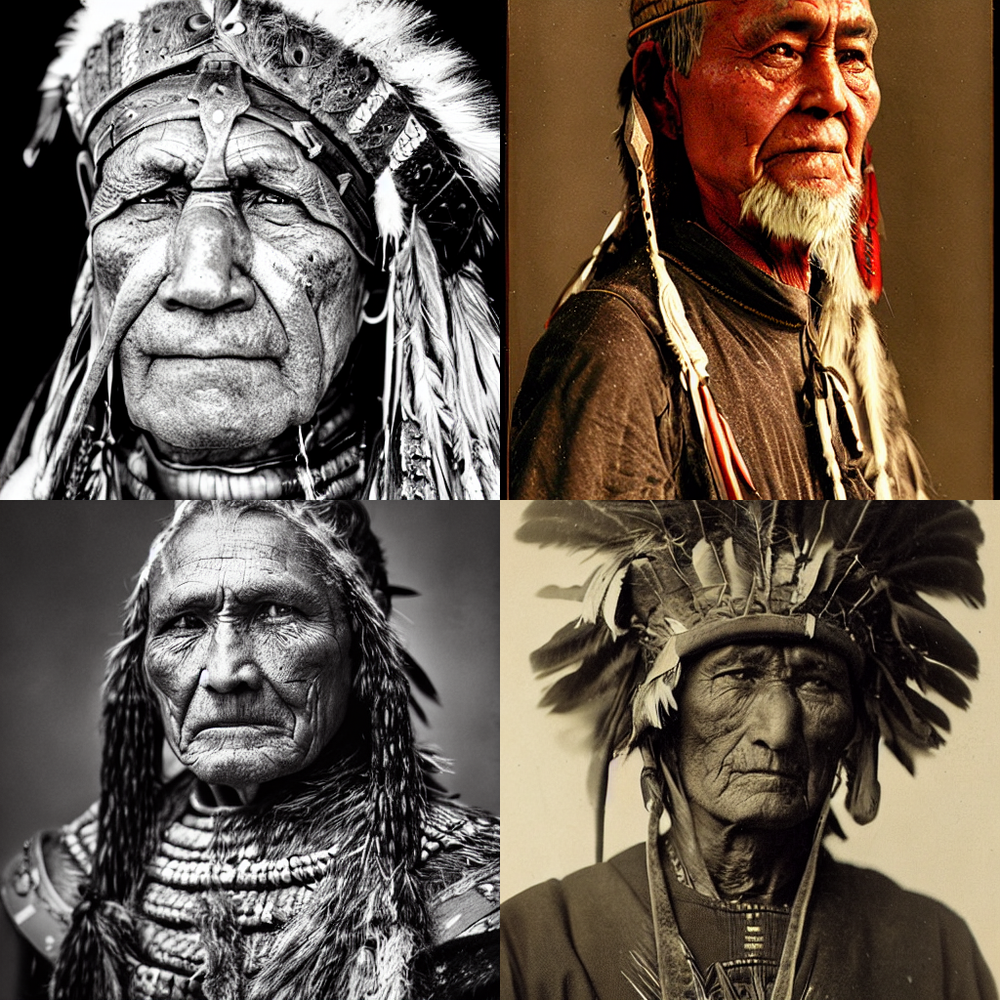

In [42]:
images = pipe.grid(**get_inputs(batch_size=4))   
clear_output()                                                                                                                                                                                       
image_grid(images)  

  0%|          | 0/20 [00:00<?, ?it/s]

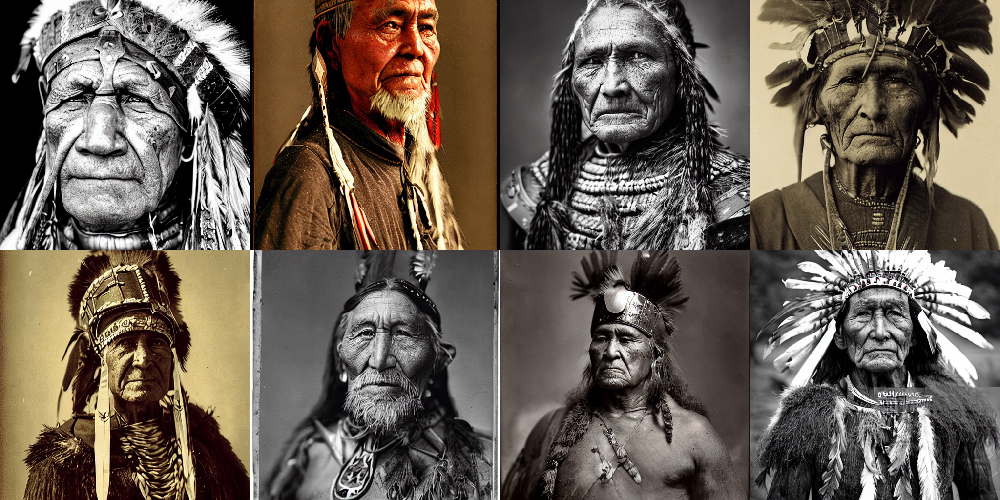

In [43]:
images = pipe.grid(**get_inputs(batch_size=8))                                                                                                                                                                                           
image_grid(images, rows=2, cols=4)  

In [44]:
from diffusers import AutoencoderKL    
vae = AutoencoderKL.from_pretrained("stabilityai/sd-vae-ft-mse", torch_dtype=torch.float16).to("cuda") 

In [45]:
pipe.set_vae(vae)

  0%|          | 0/20 [00:00<?, ?it/s]

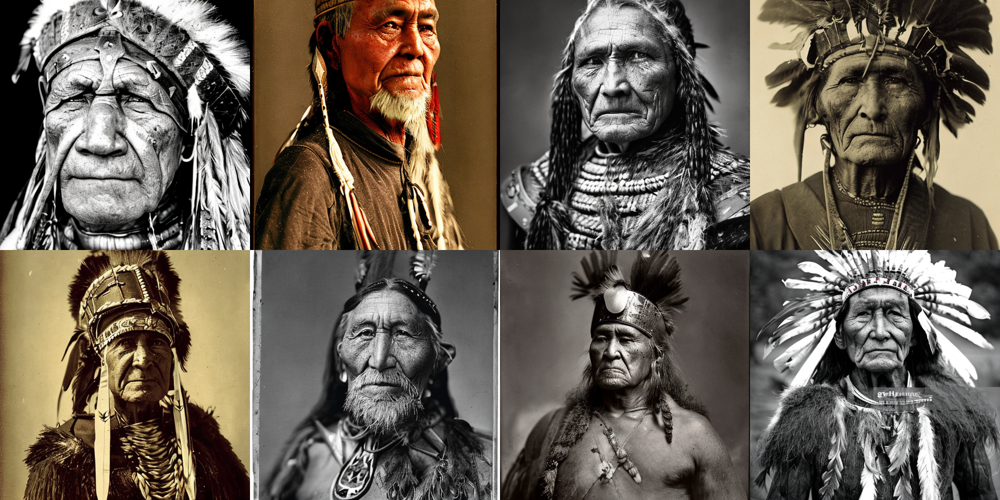

In [48]:
images = pipe.grid(**get_inputs(batch_size=8))                                                                                                                                                                                            
image_grid(images, rows=2, cols=4)    

  0%|          | 0/20 [00:00<?, ?it/s]

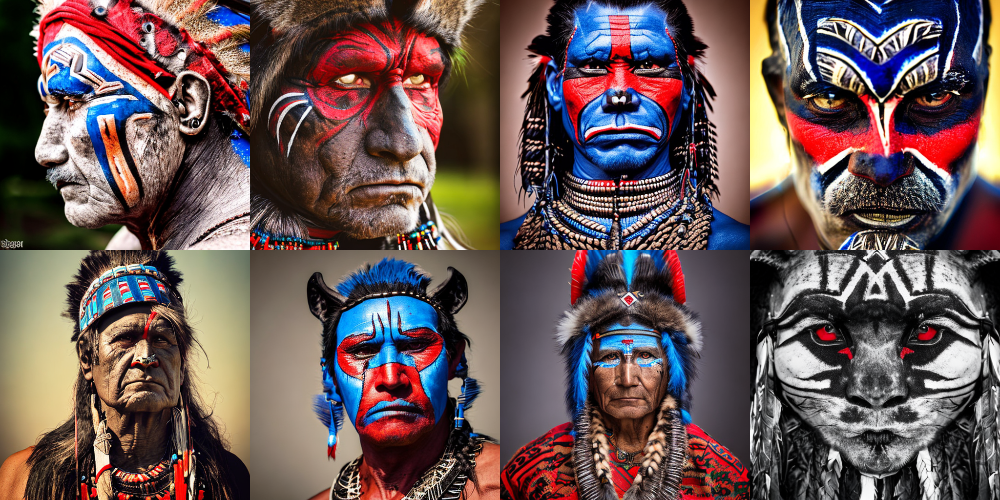

In [49]:
prompt += ", tribal panther make up, blue on red, side profile, looking away, serious eyes"
prompt += " 50mm portrait photography, hard rim lighting photography--beta --ar 2:3  --beta --upbeta"                                                                                                                                         
images = pipe.grid(**get_inputs(batch_size=8))                                                                                                                                                                                              
image_grid(images, rows=2, cols=4)                                                                                                                                                                                                                                                                                                                                                                                                                                                  


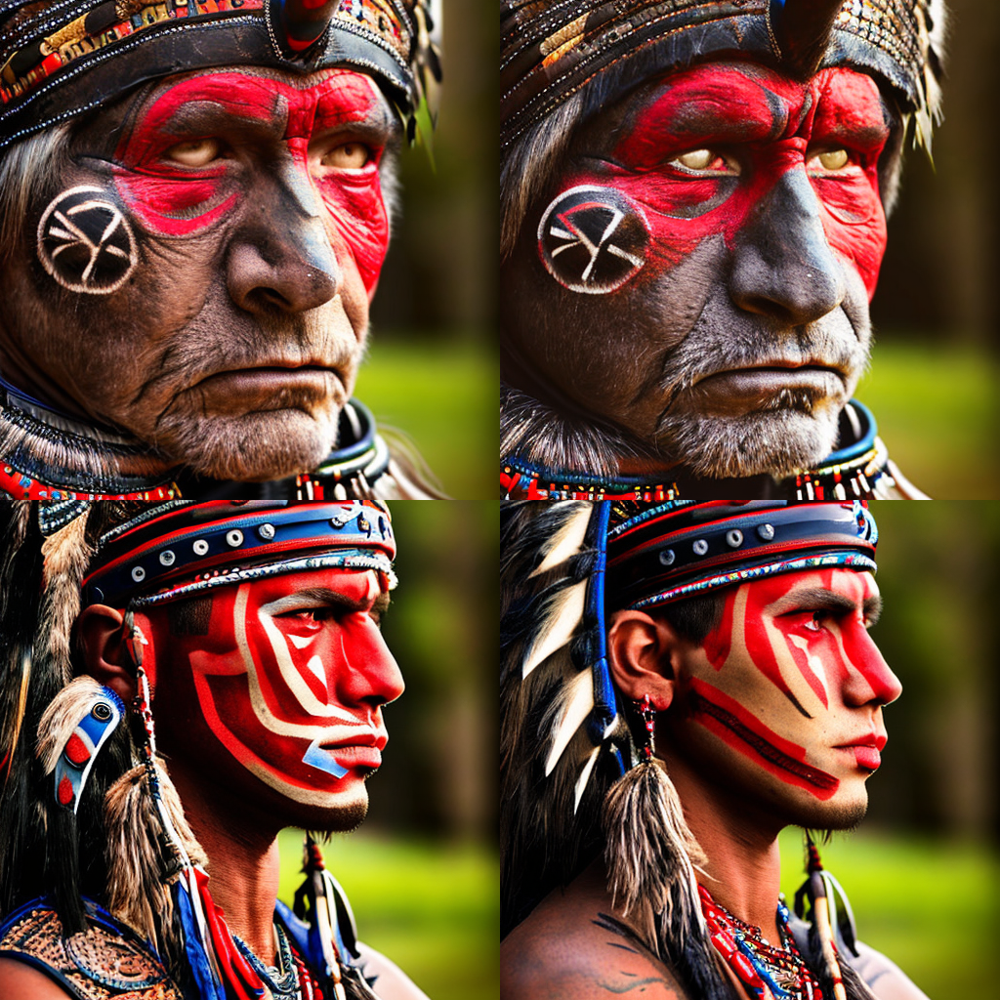

In [51]:
prompts = [                                                                                                                                                                                                                                   
    "portrait photo of the oldest warrior chief, tribal panther make up, blue on red, side profile, looking away, serious eyes 50mm portrait photography, hard rim lighting photography--beta --ar 2:3  --beta --upbeta",                                                                                                                                                                                                                                                                   
    "portrait photo of a old warrior chief, tribal panther make up, blue on red, side profile, looking away, serious eyes 50mm portrait photography, hard rim lighting photography--beta --ar 2:3  --beta --upbeta",                                                                                                                                                                                                                                                                        
    "portrait photo of a warrior chief, tribal panther make up, blue on red, side profile, looking away, serious eyes 50mm portrait photography, hard rim lighting photography--beta --ar 2:3  --beta --upbeta",                                                                                                                                                                                                                                                                            
    "portrait photo of a young warrior chief, tribal panther make up, blue on red, side profile, looking away, serious eyes 50mm portrait photography, hard rim lighting photography--beta --ar 2:3  --beta --upbeta",                                                                                                                                                                                                                                                                      
]                                                                                                                                                                                                                                             

generator = [torch.Generator("cuda").manual_seed(1) for _ in range(len(prompts))]  # 1 because we want the 2nd image                                                                                                                          
images = pipe.grid(prompt=prompts, generator=generator, num_inference_steps=25)
clear_output()
image_grid(images) 